# Import

In [1]:
%load_ext autoreload
%autoreload 2
import os

import scanpy as sc

import matplotlib.pyplot as plt
import time
import numpy as np
import torch
import pandas as pd

from inVAE import FinVAE

sc.set_figure_params(dpi=200,figsize=(6,4),fontsize=10,frameon=False)

# Load Data

In [2]:
import sys
sys.path.append('../')

In [3]:
data_dir = '/lustre/scratch126/cellgen/team292/ha10/data/Heart_Atlas/'

In [33]:
adata = sc.read(data_dir+'HeartData.h5ad')

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [ ]:
adata_labels = sc.read(data_dir+'HeartData_with_predictions.h5ad')

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [39]:
adata.obs['predicted_labels'] = adata_labels.obs['predicted_labels']

In [40]:
del adata_labels

## Filtering genes and cells: RNA-seq

In [41]:
adata.layers['counts'] = adata.X
adata.var_names_make_unique()
adata.raw = adata.copy()

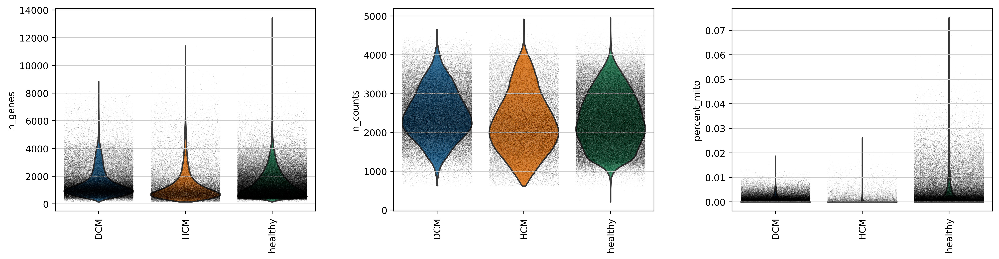

In [67]:
# number of genes per cell
plt.rcParams['figure.figsize'] = [5, 4]
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],jitter=0.4, multi_panel=True, groupby = 'condition', show=True, size = 0.1,  rotation=90)

In [68]:
sc.pp.filter_genes(adata, min_cells=3)
#sc.pp.filter_cells(rna_adata, min_genes=150)

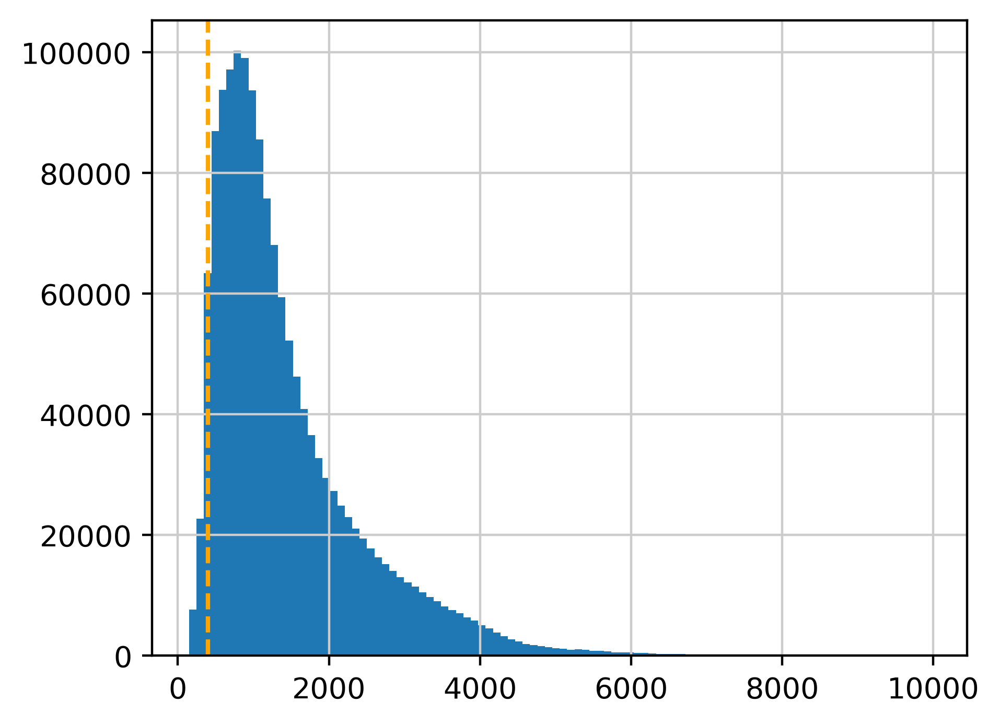

In [69]:
plt.hist(adata[adata.obs['n_genes']<10000].obs['n_genes'], bins = 100)
plt.axvline(400, linestyle = '--', color = 'orange')

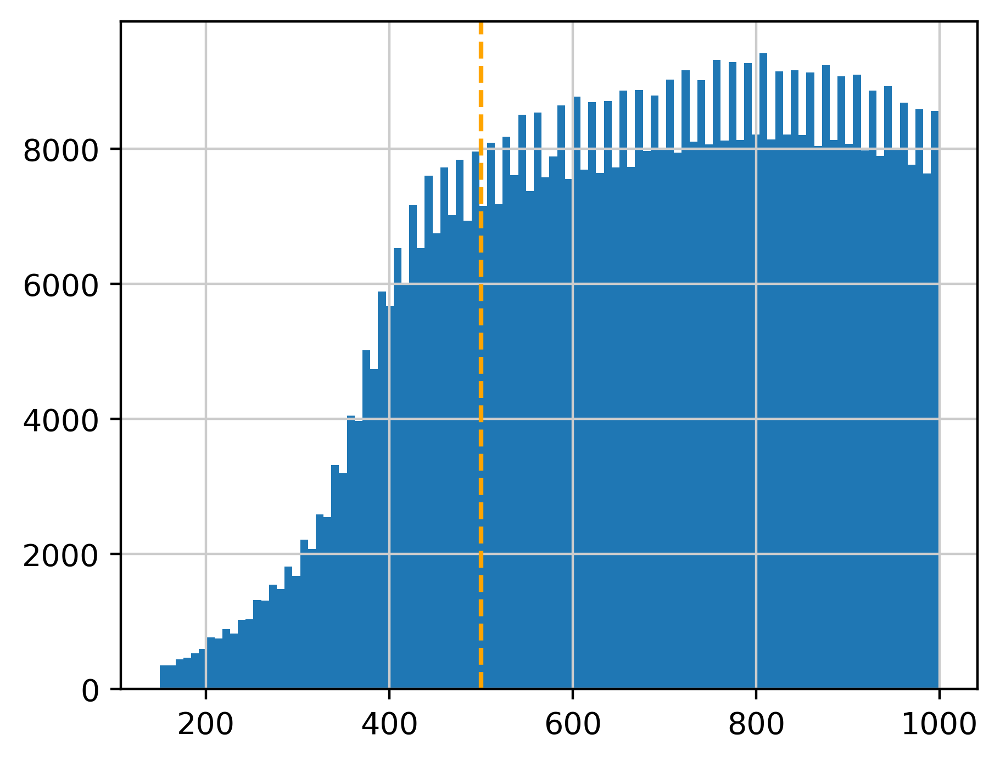

In [70]:
plt.hist(adata[adata.obs['n_genes']<1000].obs['n_genes'], bins = 100)
plt.axvline(500, linestyle = '--', color = 'orange')

In [71]:
#sc.pp.filter_cells(adata, min_genes=400) #Seung:500

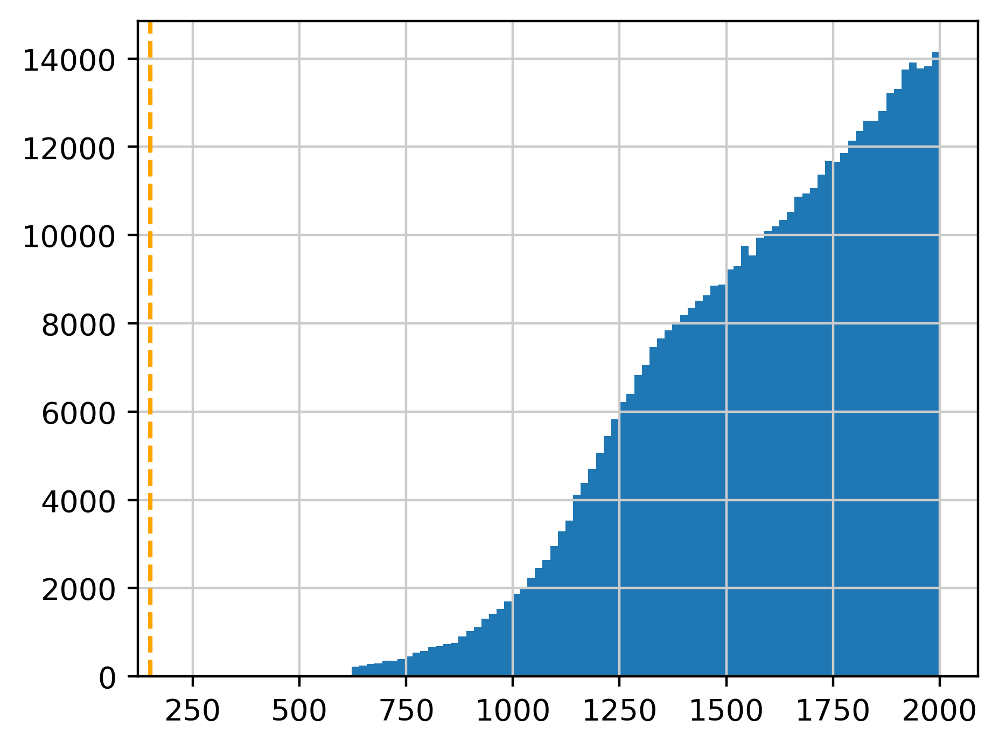

In [72]:
plt.hist(adata[adata.obs['n_counts']<2000].obs['n_counts'], bins = 100)
plt.axvline(150, linestyle = '--', color = 'orange')

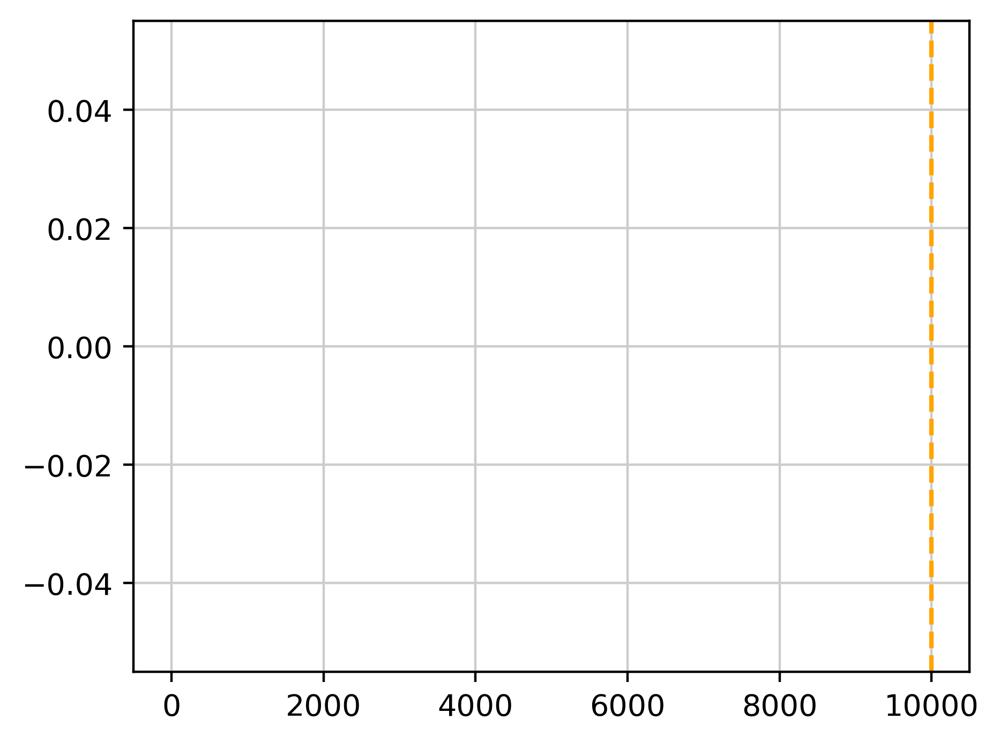

In [73]:
plt.hist(adata[adata.obs['n_counts']>20000].obs['n_counts'], bins = 100)
plt.axvline(10000, linestyle = '--', color = 'orange')

In [74]:
# remove high counts cells
adata = adata[adata.obs['n_counts'] < 20000, :] #Seung: 100000

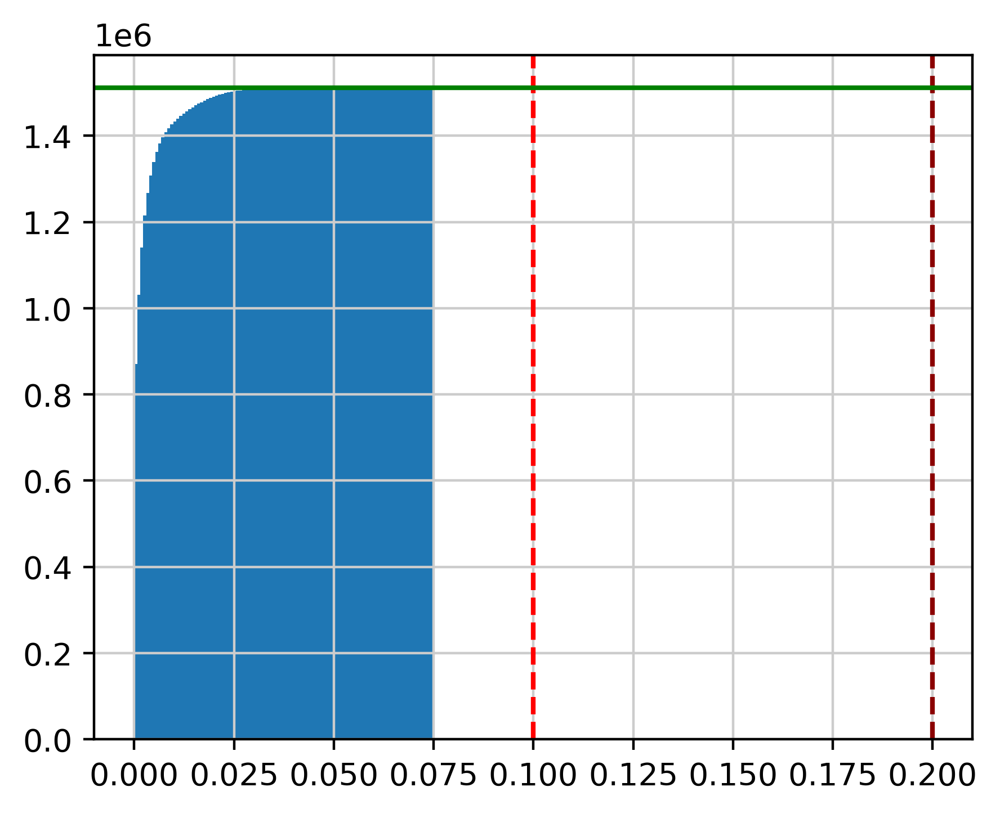

In [75]:
plt.hist(adata.obs['percent_mito'], bins = 100, cumulative=True)
plt.axvline(0.1, linestyle = '--', color = 'red')
plt.axvline(0.2, linestyle = '--', color = 'darkred')
plt.axhline(adata.n_obs*0.9999, linestyle = '-', color = 'green')

In [76]:
# Seung: >20%
adata = adata[adata.obs['percent_mito'] < 0.2, :]

In [77]:
print('Total number of cells: {:d}'.format(adata.n_obs))
print('Total number of genes: {:d}'.format(adata.n_vars))

Total number of cells: 1511309
Total number of genes: 34504


In [78]:
adata.raw = adata.copy()


/tmp/ipykernel_12986/3971365233.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata.raw = adata.copy()


In [10]:
adata.write(data_dir+'adata_QC.h5')

## Preprocessing

In [42]:
#Normalize total counts per cell
prna_adata = adata.copy()
del adata
#prna_adata.raw = rna_adata
prna_adata.layers["counts"] = prna_adata[prna_adata.obs_names, prna_adata.var_names].X.copy()

sc.pp.normalize_per_cell(prna_adata, counts_per_cell_after=1e4)
# Logarithmize the data matrix
sc.pp.log1p(prna_adata)

In [ ]:
# Extract highly variable genes
sc.pp.highly_variable_genes(prna_adata,n_top_genes=4000,batch_key='publication')

In [ ]:
prna_adata = prna_adata[:, prna_adata.var["highly_variable"]]

In [ ]:
prna_adata = prna_adata[np.random.permutation(prna_adata.obs_names)]

In [ ]:
prna_adata

In [48]:
prna_adata.write(data_dir+'adata_processed.h5')

In [4]:
prna_adata = sc.read(data_dir+'adata_processed.h5')

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
adata_train = prna_adata[:400000]

In [7]:
del prna_adata

In [4]:
adata_train.write(data_dir+'adata_train_400k.h5ad')

NameError: name 'adata_train' is not defined

In [15]:
spur_latent = model.get_latent_representation(latent_type='spur')

Using saved adata for latent representation!


In [16]:
adata_train.obsm['X_FinVAE_spur'] = spur_latent

sc.pp.neighbors(adata_train, use_rep='X_FinVAE_spur')
sc.tl.umap(adata_train)

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


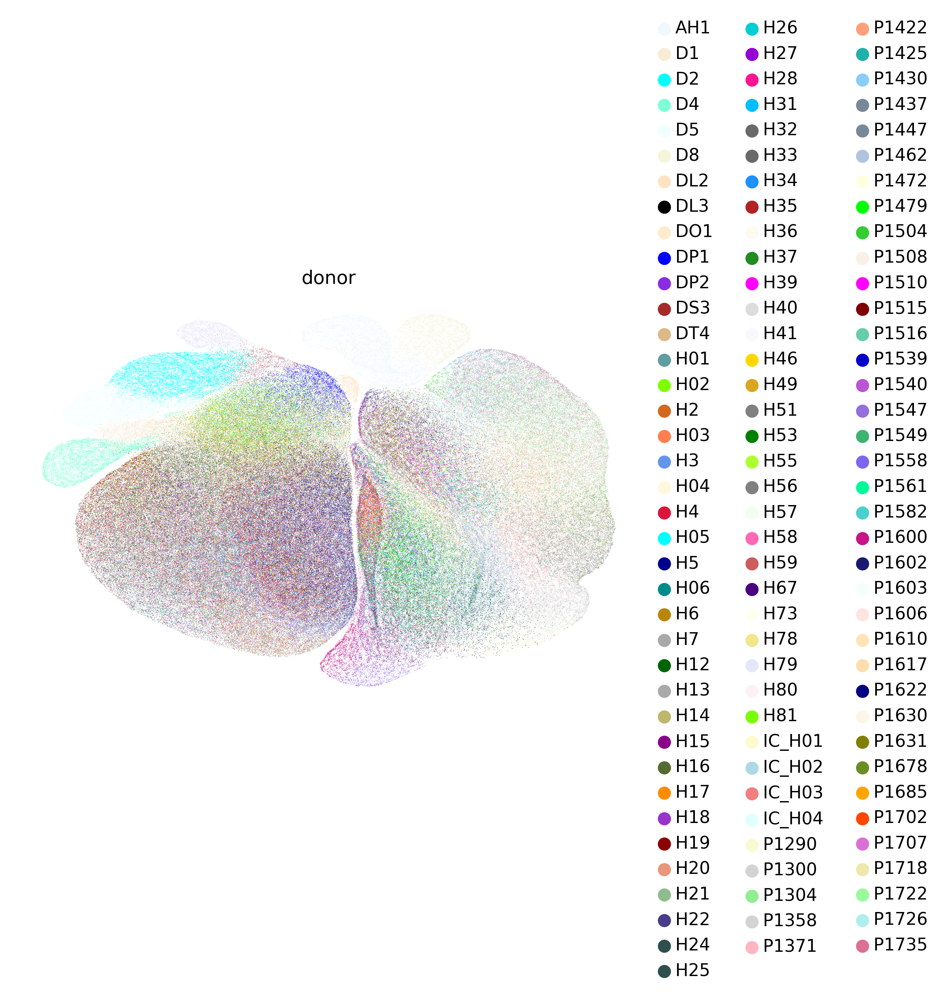

In [17]:
sc.pl.umap(adata_train,color='donor',palette=list(matplotlib.colors.CSS4_COLORS.values()))

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


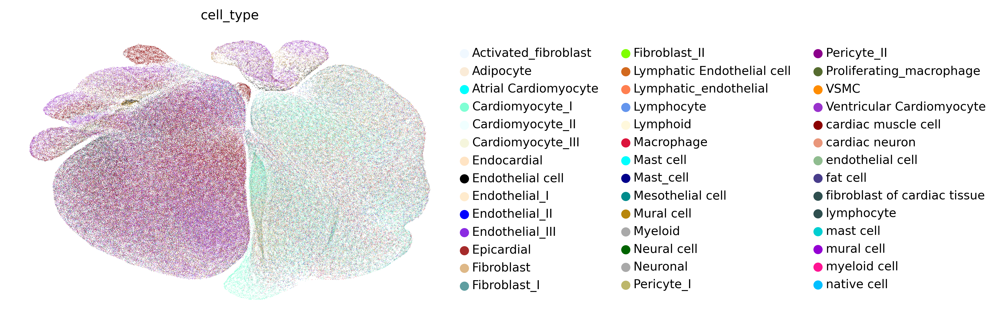

In [18]:
sc.pl.umap(adata_train,color='cell_type',palette=list(matplotlib.colors.CSS4_COLORS.values()))

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


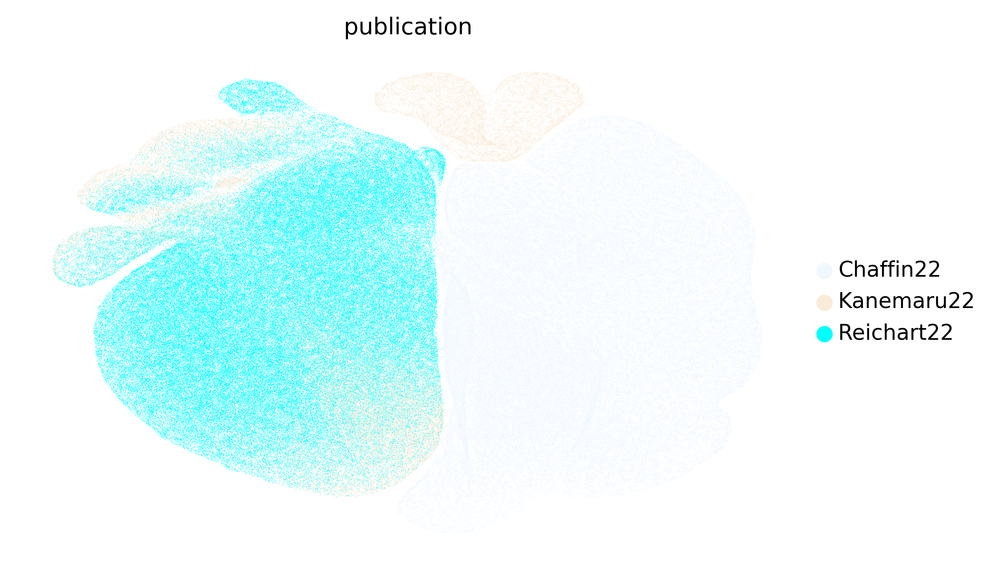

In [19]:
sc.pl.umap(adata_train,color='publication')

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


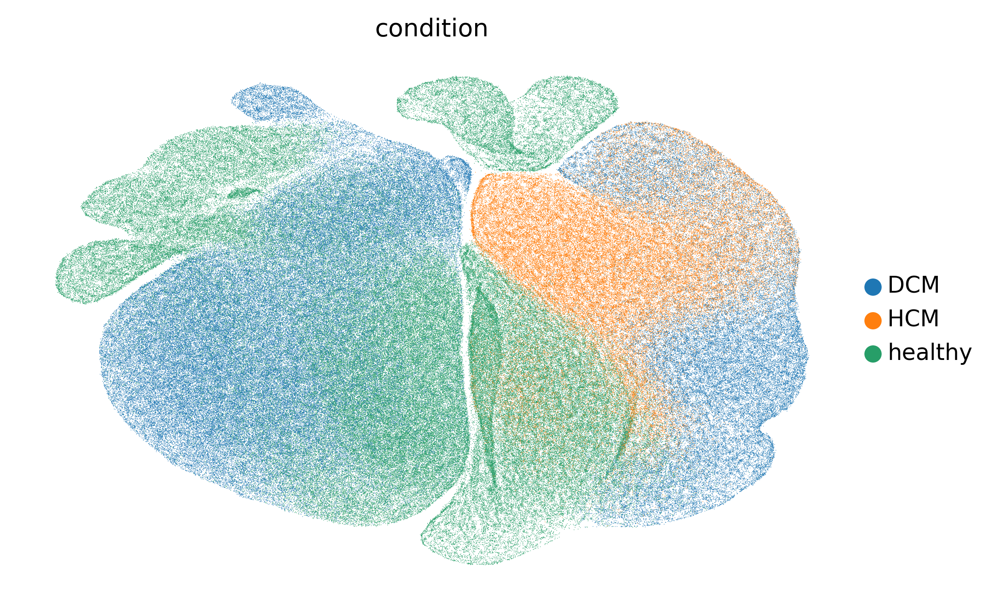

In [20]:
sc.pl.umap(adata_train,color='condition')